In [1]:
#imports
import os
import cv2
import torch
import torchvision
import numpy as np
import torch.nn as nn
import matplotlib.pyplot as plt
from torchvision.models import resnet50
from torchvision import transforms 
from resnet_models import ResNet50_GradCam, ResNet50_CBAM

In [2]:
def load_model(model, checkpoint, device='cpu'):
    model.load_state_dict(torch.load(checkpoint))#, map_location=torch.device('cpu')))
    model.eval()
    model.to(device)
    return model
    
def get_image_results(cam_model, image_file, device='cpu'):
    img = plt.imread(image_file)
    img = transforms.ToPILImage()(img)
    img = transformations(img)
    img = img.unsqueeze(0)
    img = img.to(device)
    res = cam_model.forward(img)
    pred = res.argmax(dim=1)

    res[:,pred.item()].backward()

    return img, res, pred, cam_model

def get_heatmap(cam_model, img, show_heatmap=False):
    # pull the gradients out of the model
    gradients = cam_model.get_activations_gradient()

    # pool the gradients across the channels
    pooled_gradients = torch.mean(gradients, dim=[0, 2, 3])

    # get the activations of the last convolutional layer
    activations = cam_model.get_activations(img).detach()

    # weight the channels by corresponding gradients
    for i in range(512):
        activations[:, i, :, :] *= pooled_gradients[i]

    # average the channels of the activations
    heatmap = torch.mean(activations, dim=1).squeeze()

    # relu on top of the heatmap
    # expression (2) in https://arxiv.org/pdf/1610.02391.pdf
    heatmap = heatmap.cpu()

    heatmap = np.maximum(heatmap, 0)

    # normalize the heatmap
    heatmap /= torch.max(heatmap)
    
    if show_heatmap:
        # draw the heatmap
        plt.matshow(heatmap.squeeze())

    heatmap = heatmap.numpy()
    
    return heatmap


def generate_superimposition(image_file, heatmap, model_name="finetuned_gradcam", outputs ='./outputs'):
    if not os.path.exists(outputs):
        os.mkdir(outputs)
    
    res_folder = outputs +'/'+model_name
    if not os.path.exists(res_folder):
        os.mkdir(res_folder)
    
    filename = image_file.split('/')[-1]
    res_file = os.path.join(res_folder, filename.split('.jpg')[0]+'_'+model_name+'.jpg')
    img = cv2.imread(image_file)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = heatmap * 0.4 + img
    cv2.imwrite(res_file, superimposed_img)
    return image_file,res_file
    
def show_superimposition(image_file, res_file):
    rimg = plt.imread(res_file)
    oimg = plt.imread(image_file)
    fig, ax = plt.subplots(1,2,figsize=(10,10))
    plt.figure(figsize=(20,20))
    ax[0].imshow(oimg)
    ax[1].imshow(rimg)
    plt.show()
    
def get_gradcam(cam_model, image_file,model_name="finetuned_gradcam", outputs = './outputs'):
    img, res, pred, cam_model = get_image_results(cam_model, image_file)
    heatmap = get_heatmap(cam_model, img)
    image_file, res_file = generate_superimposition(image_file, heatmap, model_name)
    return image_file, res_file

def show_superimpositions(image_pairs, title="Gradcam results"):
    fig, ax = plt.subplots(len(image_pairs),2,figsize=(90,90))
    row = 0
    for image_file, res_file in image_pairs:
        oimg = plt.imread(image_file)
        rimg = plt.imread(res_file)
        
        
        ax[row, 0].imshow(oimg)
        ax[row, 1].imshow(rimg)
        
        row+=1
    plt.tight_layout() 
    plt.suptitle(title)
    plt.show() 

In [3]:
model= ResNet50_CBAM(num_classes=2, visualise=True, pretrained=True, finetune=True, attn_type='CBAM')

Freezing params...
Using resnet 50 pretrained model with cbam for finetuning
=> no checkpoint found at './attention_module/RESNET50_CBAM.pth'


In [4]:
mean=[0.485, 0.456, 0.406]
std=[0.229, 0.224, 0.225]
'''transformations = transforms.Compose([transforms.Resize((224, 224)), 
                                transforms.ToTensor(),
                                transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])])'''

transformations = transforms.Compose([transforms.Resize(256), transforms.CenterCrop(224), transforms.ToTensor(), transforms.Normalize(mean, std)])

In [5]:
#get test images
uk = './test_images/uk'
notuk = './test_images/not_uk'
uk_images = [os.path.join(uk,f) for f in os.listdir(uk) if f.endswith('.jpg')]
notuk_images = [os.path.join(notuk,f) for f in os.listdir(notuk) if f.endswith('.jpg')]

In [6]:
checkpoint = './results/resnet50_finetuned_gradcam_cbam/checkpoint.pt'
model = load_model(model, checkpoint)

In [7]:
uk_gradcam = [get_gradcam(model, image_file) for image_file in uk_images]
notuk_gradcam = [get_gradcam(model, image_file) for image_file in notuk_images]

/opt/conda/lib/python3.8/site-packages/torch/nn/functional.py:1639: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


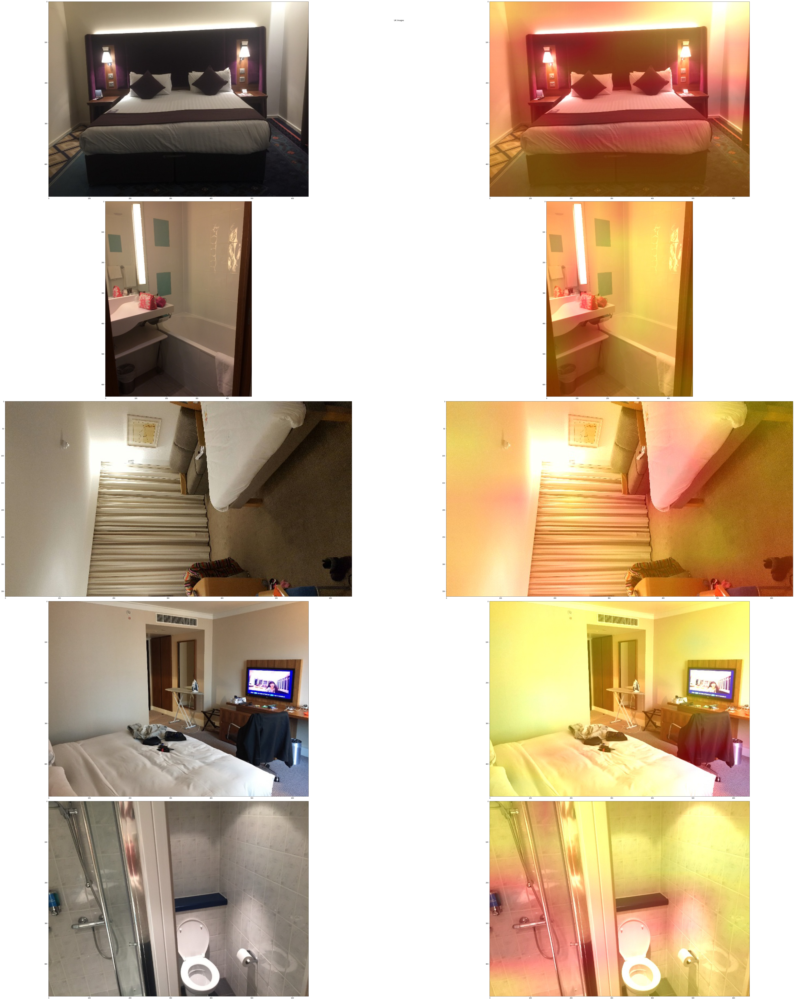

In [8]:
show_superimpositions(uk_gradcam[:5], 'UK Images')

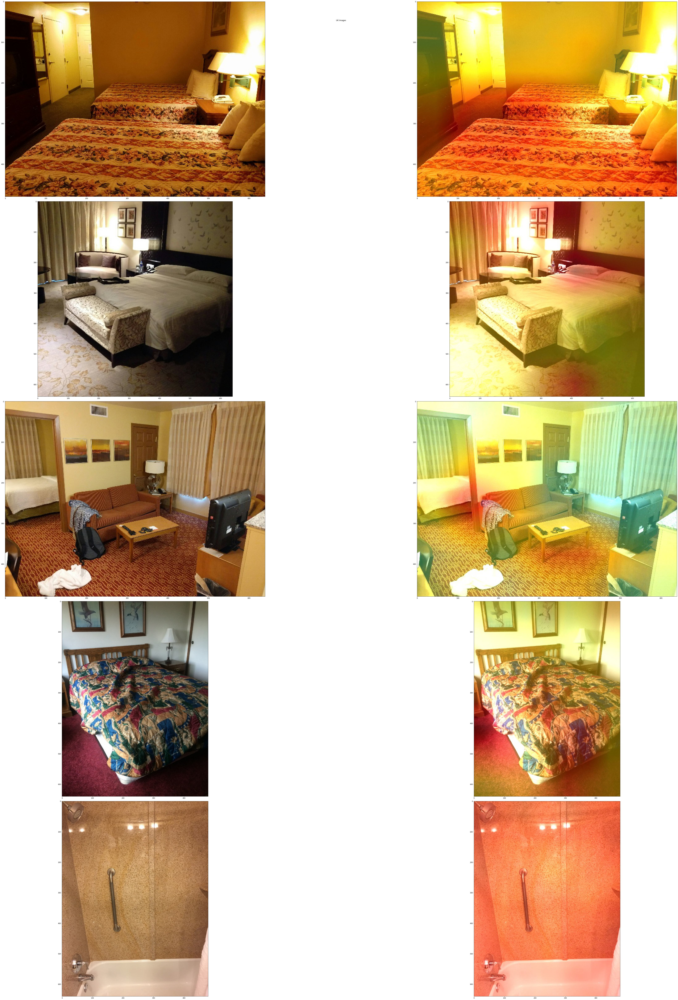

In [9]:
show_superimpositions(notuk_gradcam[:5], 'UK Images')